## Get prediction

In [4]:
%matplotlib inline
import matplotlib.pyplot as plt

import sys
import numpy as np
import torch

sys.path.insert(0, '..')
from isegm.utils import vis, exp

from isegm.inference import utils
from isegm.inference.evaluation_explainable import evaluate_sample as evaluate_sample_explainable
from isegm.inference.iterative_evaluation_training import evaluate_dataset, evaluate_sample
from isegm.inference.predictors import get_predictor
from isegm.inference.clicker import DynamicClicker
from isegm.model.is_explainable_hrnet_model import HRNetModelExplainable
from isegm.data.preprocess import Preprocessor

device = torch.device('cuda:0')
cfg = exp.load_config_file('config.yml', return_edict=True)

In [22]:
EVAL_MAX_CLICKS = 20
MODEL_THRESH = 0.5

TRAINING_OUTPUT_PATH = '/gpfs/space/projects/PerkinElmer/donatasv_experiments/repos/ClickSEG/outputs/training'

# checkpoint_path = utils.find_checkpoint(cfg.INTERACTIVE_MODELS_PATH, 'aligned_augmentations.pth')

# checkpoint_path = utils.find_checkpoint_from_training(TRAINING_OUTPUT_PATH, 'FocalClick-LIDC_2D-Static disks NormFocalLoss')
# checkpoint_path = utils.find_checkpoint_from_training(TRAINING_OUTPUT_PATH, 'FocalClick-LIDC_2D_FULL-Dynamic disks')
# checkpoint_path = utils.find_checkpoint_from_training(TRAINING_OUTPUT_PATH, 'FocalClick-LIDC_2D-Dynamic disks')
# checkpoint_path = '/gpfs/space/projects/PerkinElmer/donatasv_experiments/repos/ClickSEG/outputs/training/final_models/FocalClick-MD_PANC_2D-Dynamic disks/checkpoints/best_model.pth'
# checkpoint_path = '/gpfs/space/projects/PerkinElmer/donatasv_experiments/repos/ClickSEG/outputs/training/final_models/FocalClick-MD_PANC_2D_FULL-Dynamic disks/checkpoints/best_model.pth'

# checkpoint_path = '/gpfs/space/projects/PerkinElmer/donatasv_experiments/repos/ClickSEG/outputs/training/final_models/FocalClick-LIDC_2D_FULL-Static disks/checkpoints/best_model.pth'
# checkpoint_path = '/gpfs/space/projects/PerkinElmer/donatasv_experiments/repos/ClickSEG/outputs/training/final_models/FocalClick-LIDC_2D_FULL-Dynamic disks/checkpoints/best_model.pth'
# print(checkpoint_path)

# checkpoint_path = '/gpfs/space/projects/PerkinElmer/donatasv_experiments/repos/ClickSEG/outputs/training/final_models/FocalClick-MD_PANC_2D-Static disks/checkpoints/best_model.pth'
# checkpoint_path = '/gpfs/space/projects/PerkinElmer/donatasv_experiments/repos/ClickSEG/outputs/training/final_models/FocalClick-MD_PANC_2D-Dynamic disks/checkpoints/best_model.pth'

checkpoint_path = '/gpfs/space/projects/PerkinElmer/donatasv_experiments/repos/ClickSEG/outputs/training/final_models/FocalClick-KITS23_2D_TUMOURS_FULL-Static disks/checkpoints/best_model.pth'
# checkpoint_path = '/gpfs/space/projects/PerkinElmer/donatasv_experiments/repos/ClickSEG/outputs/training/final_models/FocalClick-KITS23_2D_TUMOURS_FULL-Dynamic disks/checkpoints/best_model.pth'


saved_model = utils.load_is_model(checkpoint_path, 'cpu', model_type='FocalClick')
# model = saved_model.to(device)
model = HRNetModelExplainable(
        pipeline_version='s2',
        width=32,
        ocr_width=128,
        small=False,
        with_aux_output=True,
        use_leaky_relu=True,
        use_rgb_conv=False,
        use_disks=True,
        norm_radius=5,
        with_prev_mask=True,
    )
saved_model = saved_model.to('cpu')
model.load_state_dict(saved_model.state_dict())
model = model.to(device)
model.eval()

# Possible choices: 'NoBRS', 'f-BRS-A', 'f-BRS-B', 'f-BRS-C', 'RGB-BRS', 'DistMap-BRS', 'FocalClick', 'FocalClickExplainable'
brs_mode = 'FocalClickExplainable'
# brs_mode = 'FocalClick'

zoom_in_params = dict()
zoom_in_params['recompute_click_size_on_zoom'] = False # True for dynamic

predictor_params = dict()
predictor_params['ensure_minimum_focus_crop_size'] = False # True for LIDC (improve first click?)

# zoom_in_params['min_crop_size'] = 200
# zoom_in_params['skip_clicks'] = 0

predictor = get_predictor(model, brs_mode, device, prob_thresh=MODEL_THRESH, zoom_in_params=zoom_in_params, predictor_params=predictor_params, infer_size=256)


Model args: {'pipeline_version': 's2', 'width': 32, 'ocr_width': 128, 'small': False, 'with_aux_output': True, 'use_leaky_relu': True, 'use_rgb_conv': False, 'dist_map_mode': 'disk', 'norm_radius': 5, 'with_prev_mask': True, 'overwrite_click_maps': False, 'model_type': 'FocalClick'}


In [23]:
# Possible choices: 'DAVIS', 'BRATS', 'LIDC', 'LIDC_2D_VAL', 'LIDC_2D_256_VAL', 'LIDC_CROPS_BOXED', 'LIDC_CROPS_WHITENED', 'LIDC_CROPS'
DATASET = 'KITS23_2D_TUMOURS_FULL_VAL'
preprocessor = Preprocessor()
preprocessor.normalize = True
preprocessor.windowing = True
preprocessor.window_min = -150
preprocessor.window_max = 250
# preprocessor.convert_to_rgb = True

dataset = utils.get_dataset(DATASET, cfg, preprocessor=preprocessor)

[0.58893 0.72603 0.82784 0.8015  0.7803  0.77606 0.76172 0.81273 0.84706
 0.8189  0.78571 0.77143 0.77959 0.82857 0.81224 0.80408 0.80488 0.8
 0.8     0.8    ]


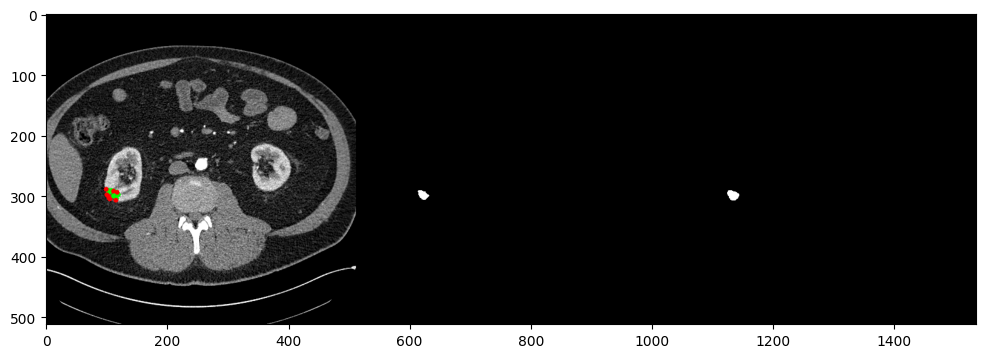

In [49]:
sample_id = 14 # 28
TARGET_IOU = 1

sample = dataset.get_sample(sample_id)

gt_mask = sample.gt_mask
image = sample.image
init_mask = np.zeros_like(gt_mask)

#mode = min, avg, max, distributed
clicker = DynamicClicker(gt_mask, mode='locked')

clicks_list, ious_arr, pred, pred_list, info_list = evaluate_sample_explainable(image, gt_mask, init_mask, predictor, clicker,
                                              pred_thr=MODEL_THRESH, 
                                              max_iou_thr=TARGET_IOU, max_clicks=EVAL_MAX_CLICKS,)
pred_mask = pred_list[-1] > MODEL_THRESH
draw = vis.draw_with_blend_and_clicks(image, mask=pred_mask, clicks_list=clicks_list)
draw = np.concatenate((draw,
    255 * pred_mask[:, :, np.newaxis].repeat(3, axis=2),
    255 * (gt_mask > 0)[:, :, np.newaxis].repeat(3, axis=2)
), axis=1)
print(np.round(ious_arr, 5))
plt.figure(figsize=(12, 18))
plt.imshow(draw)
plt.show()

# ious_arr = evaluate_sample(image, gt_mask, init_mask, predictor, clicker, max_clicks=EVAL_MAX_CLICKS, max_iou_thr=TARGET_IOU)
# ious_arr

# Visualise progression graph:

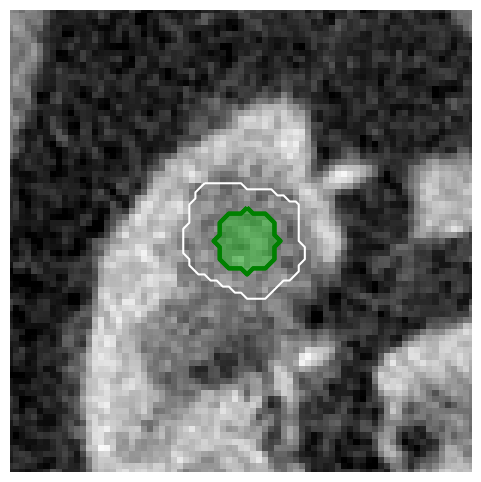

In [38]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import base64

def extract_click_maps(info_list):
    pos_click_maps = []
    neg_click_maps = []
    for info in info_list:
        pos_click_maps.append(info['coarse_seg']['click_map'][0, 0].cpu())
        neg_click_maps.append(info['coarse_seg']['click_map'][0, 1].cpu())
    return pos_click_maps, neg_click_maps

def show_clicks(image, gt_mask, iou_values, pos_click_maps, neg_click_maps, predictions, info_list, frame_index):
    rows = np.any(gt_mask, axis=1)
    cols = np.any(gt_mask, axis=0)
    ymin, ymax = np.where(rows)[0][[0, -1]]
    xmin, xmax = np.where(cols)[0][[0, -1]]

    box_height = ymax - ymin
    box_width = xmax - xmin
    max_side = max(box_height, box_width) * 4

    center_y = ymin + box_height // 2
    center_x = xmin + box_width // 2
    half_side = max_side // 2

    square_ymin = max(0, center_y - half_side)
    square_ymax = min(image.shape[0], center_y + half_side)
    square_xmin = max(0, center_x - half_side)
    square_xmax = min(image.shape[1], center_x + half_side)

    fig, ax = plt.subplots(1, 1, figsize=(6, 6), frameon=False)
    plt.close()
    
    ax.axis('off')
    ax.imshow(image, cmap='gray')
    ax.set_xlim(square_xmin, square_xmax)
    ax.set_ylim(square_ymax, square_ymin)
    ax.contour(gt_mask, colors='w', levels=[0.5])
    
    # Add contour of ground truth mask
    # ax.contour(gt_mask, colors='w', levels=[0.5])  # Drawing contour in white color
    
    # Retrieve the ROI for the current frame
    roi = info_list[frame_index]['image_transforms']['roi']
    ymin, ymax, xmin, xmax = roi if roi is not None else (0, 512,  0, 512)
    # print(ymin, ymax, xmin, xmax)
    
    # Overlay for positive clicks
    # ax.set_xlim(xmin, xmax)
    # ax.set_ylim(ymax, ymin)
    # pos_click_map = np.zeros_like(image)
    
    # pos_click_map[ymin:ymax, xmin:xmax] = torch.nn.functional.interpolate(
    #     info_list[frame_index]['coarse_seg']['click_map'][0, 0].cpu().unsqueeze(0).unsqueeze(0),
    #     size=(ymax - ymin, xmax - xmin),
    #     mode='bilinear',
    #     align_corners=True,
    # ).squeeze(0).squeeze(0)
    # pos_click_map[pos_click_map > 0] = 1
    
    
    # pos_click_map = info_list[frame_index]['coarse_seg']['click_map'][0, 0].cpu()
    # neg_click_map = info_list[frame_index]['coarse_seg']['click_map'][0, 1].cpu()
    # print(pos_click_map.shape)
    
        
    clicks = predictor.get_points_nd(info_list[frame_index]['raw_clicks'])
    click_maps = model.dist_maps_base(np.zeros((1, 1, 512, 512)), clicks)
    pos_click_map = click_maps[0, 0].cpu()
    neg_click_map = click_maps[0, 1].cpu()
    
    
    pos_overlay = np.ma.masked_where(pos_click_map == 0, pos_click_map)
    ax.imshow(np.dstack((np.zeros_like(pos_overlay), pos_overlay, np.zeros_like(pos_overlay), pos_overlay*0.3)), interpolation='nearest')
        
    # Overlay for negative clicks
    # neg_click_map = np.zeros_like(image)
    # neg_click_map[ymin:ymax, xmin:xmax] = torch.nn.functional.interpolate(
    #     neg_click_maps[frame_index].unsqueeze(0).unsqueeze(0),
    #     size=(ymax - ymin, xmax - xmin),
    #     mode='bilinear',
    #     align_corners=True,
    # ).squeeze(0).squeeze(0)
    # neg_click_map[neg_click_map > 0] = 1
    
    
    neg_overlay = np.ma.masked_where(neg_click_map == 0, neg_click_map)
    ax.imshow(np.dstack((neg_overlay, np.zeros_like(neg_overlay), np.zeros_like(neg_overlay), neg_overlay*0.3)), interpolation='nearest')

    for k in range(len(clicks[0])):
        for idx in range(len(clicks[0])):
            if k == clicks[0,idx,2]:
                i = idx
        current = clicks.clone()
        for j in range(len(clicks[0])):
            if j != i:
                current[0, j] = clicks[0, -1]	
        map = model.dist_maps_base(np.zeros((1, 1, 512, 512)), current)
        positive = i < len(clicks[0]) / 2
        cont = map[0, 0].cpu() if positive else map[0,1].cpu()
        ax.contour(cont, colors='g' if positive else 'r', levels=[0.5], linewidths=3)
    
    
    # for k in range(len(clicks[0])):
    #     for idx in range(len(clicks[0])):
    #         if k == clicks[0,idx,2]:
    #             i = idx
    #     positive = i < len(clicks[0]) / 2
    #     raw_map = pos_click_maps[i].unsqueeze(0).unsqueeze(0) if positive else neg_click_maps[i].unsqueeze(0).unsqueeze(0)
    #     click_map = np.zeros_like(image)
    #     click_map[ymin:ymax, xmin:xmax] = torch.nn.functional.interpolate(
    #     raw_map,
    #     size=(ymax - ymin, xmax - xmin),
    #     mode='bilinear',
    #     align_corners=True,
    #     ).squeeze(0).squeeze(0)
    #     click_map[click_map > 0] = 1
    #     ax.contour(click_map, colors='g' if positive else 'r', levels=[0.5], linewidths=3)
        
    
    return fig
    
pos_click_maps, neg_click_maps = extract_click_maps(info_list)

show_clicks(image[:, :, 0], gt_mask, ious_arr, pos_click_maps, neg_click_maps, pred_list, info_list, 0)

(292.0, 236.0)

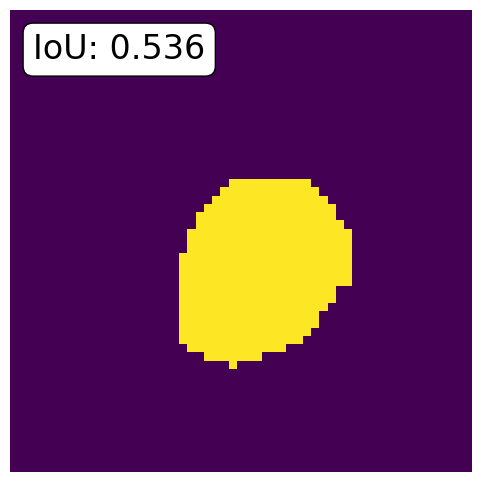

In [39]:
rows = np.any(gt_mask, axis=1)
cols = np.any(gt_mask, axis=0)
ymin, ymax = np.where(rows)[0][[0, -1]]
xmin, xmax = np.where(cols)[0][[0, -1]]
box_height = ymax - ymin
box_width = xmax - xmin
max_side = max(box_height, box_width) * 3
center_y = ymin + box_height // 2
center_x = xmin + box_width // 2
half_side = max_side // 2
square_ymin = max(0, center_y - half_side)
square_ymax = min(image.shape[0], center_y + half_side)
square_xmin = max(0, center_x - half_side)
square_xmax = min(image.shape[1], center_x + half_side)
fig, ax = plt.subplots(1, 1, figsize=(6, 6), frameon=False)

index = 0

ax.imshow(pred_list[index])
ax.axis('off')
props = dict(boxstyle='round', facecolor='white', alpha=1)
ax.text(0.05, 0.95, f'IoU: {ious_arr[0]:.3f}', transform=ax.transAxes, fontsize=24,
        verticalalignment='top', bbox=props)
ax.axis('off')
ax.set_xlim(square_xmin, square_xmax)
ax.set_ylim(square_ymax, square_ymin)

In [18]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import base64

def show_animation(animation):
    html = animation.to_jshtml()
    return HTML(html)

def save_animation(animation, filename):
    animation.save(f'{filename}.gif', writer='pillow')

def generate_click_animation(image, gt_mask, iou_values, pos_click_maps, neg_click_maps, predictions, info_list):
    rows = np.any(gt_mask, axis=1)
    cols = np.any(gt_mask, axis=0)
    ymin, ymax = np.where(rows)[0][[0, -1]]
    xmin, xmax = np.where(cols)[0][[0, -1]]

    box_height = ymax - ymin
    box_width = xmax - xmin
    max_side = max(box_height, box_width) * 5

    center_y = ymin + box_height // 2
    center_x = xmin + box_width // 2
    half_side = max_side // 2

    square_ymin = max(0, center_y - half_side)
    square_ymax = min(image.shape[0], center_y + half_side)
    square_xmin = max(0, center_x - half_side)
    square_xmax = min(image.shape[1], center_x + half_side)

    fig, ax = plt.subplots(1, 4, figsize=(24, 8))

    iou_values = np.append(np.array([0]), iou_values)
    num_frames = len(predictions)
    
    for a in ax[:3]:
        a.axis('off')
        a.set_xlim(square_xmin, square_xmax)
        a.set_ylim(square_ymax, square_ymin)
        a.imshow(image, cmap='gray')
    
    ax[0].set_title('Initial', fontsize=20)
    ax[1].set_title(f'IOU: {iou_values[0]:.3f}', fontsize=20)

    ax[3].set_xticks(np.arange(1, len(iou_values) + 1))
    ax[3].set_ylim(0, 1.05)
    ax[3].set_xlabel('Clicks')
    ax[3].set_ylabel('IOU')
    ax[3].set_title('IOU after each click', fontsize=20)
    
    plt.close()
    
    def update(frame_index):
        for a in ax[:3]:
            a.imshow(image, cmap='gray')
            a.set_xlim(square_xmin, square_xmax)
            a.set_ylim(square_ymax, square_ymin)
        ax[0].set_title(f'Input', fontsize=20)

        ax[1].set_title(f'Clicks: {frame_index + 1}', fontsize=20)
        
        # Add contour of ground truth mask
        ax[1].contour(gt_mask, colors='w', levels=[0.5])  # Drawing contour in white color
        
        # Retrieve the ROI for the current frame
        roi = info_list[frame_index]['image_transforms']['roi']
        ymin, ymax, xmin, xmax = roi if roi is not None else (0, 512,  0, 512)
        
        # Overlay for positive clicks
        pos_click_map = np.zeros_like(image)
        
        # print(pos_click_map[ymin:ymax, xmin:xmax].shape, pos_click_maps[frame_index].shape)
        pos_click_map[ymin:ymax, xmin:xmax] = torch.nn.functional.interpolate(
            pos_click_maps[frame_index].unsqueeze(0).unsqueeze(0),
            size=(ymax - ymin, xmax - xmin),
            mode='bilinear',
            align_corners=True,
        ).squeeze(0).squeeze(0)
        
        
        pos_overlay = np.ma.masked_where(pos_click_map == 0, pos_click_map)
        ax[1].imshow(np.dstack((np.zeros_like(pos_overlay), pos_overlay, np.zeros_like(pos_overlay), pos_overlay*0.5)), interpolation='nearest')

        # Overlay for negative clicks
        neg_click_map = np.zeros_like(image)
        neg_click_map[ymin:ymax, xmin:xmax] = torch.nn.functional.interpolate(
            neg_click_maps[frame_index].unsqueeze(0).unsqueeze(0),
            size=(ymax - ymin, xmax - xmin),
            mode='bilinear',
            align_corners=True,
        ).squeeze(0).squeeze(0)
        
        neg_overlay = np.ma.masked_where(neg_click_map == 0, neg_click_map)
        ax[1].imshow(np.dstack((neg_overlay, np.zeros_like(neg_overlay), np.zeros_like(neg_overlay), neg_overlay*0.5)), interpolation='nearest')

        if frame_index < len(predictions):
            prediction_masked = np.ma.masked_where(predictions[frame_index] == 0, predictions[frame_index])
            ax[2].imshow(prediction_masked, alpha=0.5, cmap='gist_rainbow')
            ax[2].set_title(f'IOU: {iou_values[frame_index + 1]:.3f}', fontsize=20)
            
        ax[3].plot(np.arange(frame_index + 2), iou_values[:frame_index + 2], color='b')
        
        return
    
    animation = FuncAnimation(fig, update, frames=num_frames, interval=1000, blit=False)
    return animation

def extract_click_maps(info_list):
    pos_click_maps = []
    neg_click_maps = []
    for info in info_list:
        pos_click_maps.append(info['coarse_seg']['click_map'][0, 0].cpu())
        neg_click_maps.append(info['coarse_seg']['click_map'][0, 1].cpu())
    return pos_click_maps, neg_click_maps

pos_click_maps, neg_click_maps = extract_click_maps(info_list)

anim = generate_click_animation(image[:, :, 0], gt_mask, ious_arr, pos_click_maps, neg_click_maps, pred_list, info_list)
show_animation(anim)

# Visualise step by step

In [197]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import cv2
import base64

def show_animation(animation):
    html = animation.to_jshtml()
    return HTML(html)

def save_animation(animation, filename):
    animation.save(f'{filename}.gif', writer='pillow')

def generate_click_animation(gt_mask, iou_values, predictions, info_list):
    fig, ax = plt.subplots(1, 3, figsize=(18, 8))

    iou_values = np.append(np.array([0]), iou_values)
    num_frames = len(predictions)
    # num_frames = 2
    
    full_size_image = info_list[0]['image_transforms']['image_nd'].cpu()[0, 0]
    
    for a in ax[:3]:
        a.axis('off')
        a.imshow(full_size_image, cmap='gray')
        
    ax[0].contour(gt_mask, colors='w', levels=[0.5])
        
    
    ax[0].set_title('Scan with GT mask', fontsize=20)
    ax[2].set_title(f': {iou_values[0]:.3f}', fontsize=20)
    
    
    plt.close()
    
    def update(frame_index):
        image = info_list[frame_index]['image_transforms']['image_nd'].cpu()[0, 0]
        
        prediction_before_sigmoid = info_list[frame_index]['coarse_seg']['outputs']['instances'].cpu()[0, 0]
        prediction = (torch.sigmoid(prediction_before_sigmoid) > 0.5).numpy()
        
        if np.sum(prediction) > 0:
            rows = np.any(prediction, axis=1)
            cols = np.any(prediction, axis=0)
        else:
            rows = np.any(gt_mask, axis=1)
            cols = np.any(gt_mask, axis=0)
        ymin, ymax = np.where(rows)[0][[0, -1]]
        xmin, xmax = np.where(cols)[0][[0, -1]]

        box_height = ymax - ymin
        box_width = xmax - xmin
        max_side = max(box_height, box_width) * 5

        center_y = ymin + box_height // 2
        center_x = xmin + box_width // 2
        half_side = max_side // 2

        square_ymin = max(0, center_y - half_side)
        square_ymax = min(image.shape[0], center_y + half_side)
        square_xmin = max(0, center_x - half_side)
        square_xmax = min(image.shape[1], center_x + half_side)
        
        roi = info_list[frame_index]['image_transforms']['roi']
        ymin, ymax, xmin, xmax = roi if roi is not None else (0, 511,  0, 511)
        
        zoomed_gt_mask = (gt_mask * 255).astype(np.uint8)
        zoomed_gt_mask = zoomed_gt_mask[ymin:ymax, xmin:xmax]
        zoomed_gt_mask = cv2.resize(zoomed_gt_mask, (512, 512)) > 128
        zoomed_gt_mask = zoomed_gt_mask.astype(np.float32)
        
        for a in ax[1:]:
            a.clear()
            a.imshow(image, cmap='gray')
            a.axis('off')
            # a.set_xlim(square_xmin, square_xmax)
            # a.set_ylim(square_ymax, square_ymin)
        ax[0].set_title(f'Input', fontsize=20)

        ax[1].set_title(f'Clicks: {frame_index + 1}', fontsize=20)
        ax[1].contour(zoomed_gt_mask, colors='w', levels=[0.5])
        
        pos_click_map = info_list[frame_index]['coarse_seg']['click_map'].cpu()[0, 0]
        pos_overlay = np.ma.masked_where(pos_click_map == 0, pos_click_map)
        ax[1].imshow(np.dstack((np.zeros_like(pos_overlay), pos_overlay, np.zeros_like(pos_overlay), pos_overlay*0.5)), interpolation='nearest')
        
        neg_click_map = info_list[frame_index]['coarse_seg']['click_map'].cpu()[0, 1]
        neg_overlay = np.ma.masked_where(neg_click_map == 0, neg_click_map)
        ax[1].imshow(np.dstack((neg_overlay, np.zeros_like(neg_overlay), np.zeros_like(neg_overlay), neg_overlay*0.5)), interpolation='nearest')

        
        if frame_index < len(predictions):
            prediction_masked = np.ma.masked_where(prediction == 0, prediction)
            ax[2].imshow(prediction_masked, alpha=0.5, cmap='gist_rainbow')
            ax[2].set_title(f'IOU: {iou_values[frame_index + 1]:.3f}', fontsize=20)
        
        return
    
    animation = FuncAnimation(fig, update, frames=num_frames, interval=1000, blit=False)
    return animation

anim = generate_click_animation(gt_mask, ious_arr, pred_list, info_list)
show_animation(anim)

2024-05-03 19:41:25,329 [MainThread  ] [INFO ]  Animation.save using <class 'matplotlib.animation.HTMLWriter'>
2024-05-03 19:41:25,329 [MainThread  ] [INFO ]  Animation.save using <class 'matplotlib.animation.HTMLWriter'>
2024-05-03 19:41:25,329 [MainThread  ] [INFO ]  Animation.save using <class 'matplotlib.animation.HTMLWriter'>
2024-05-03 19:41:25,329 [MainThread  ] [INFO ]  Animation.save using <class 'matplotlib.animation.HTMLWriter'>
/gpfs/space/home/donatasv/.conda/envs/bcv_clickseg/lib/python3.7/site-packages/matplotlib/image.py:446: UserWarning: Warning: converting a masked element to nan.
  dv = np.float64(self.norm.vmax) - np.float64(self.norm.vmin)
/gpfs/space/home/donatasv/.conda/envs/bcv_clickseg/lib/python3.7/site-packages/matplotlib/image.py:453: UserWarning: Warning: converting a masked element to nan.
  a_min = np.float64(newmin)
/gpfs/space/home/donatasv/.conda/envs/bcv_clickseg/lib/python3.7/site-packages/matplotlib/image.py:458: UserWarning: Warning: converting a m

## Visualise each part

In [10]:
step_info = info_list[1]

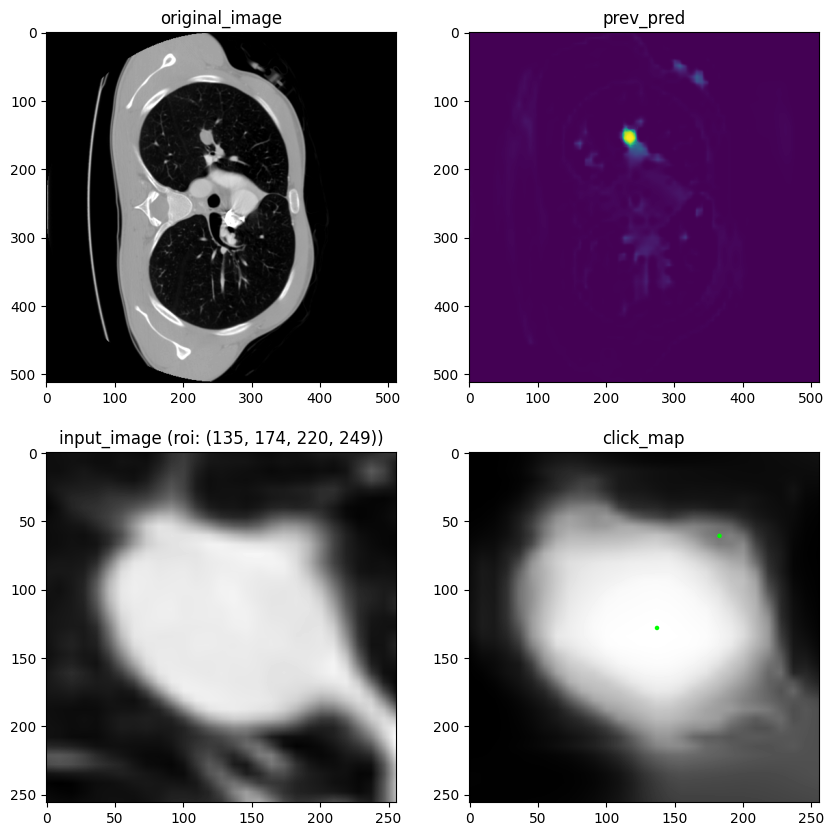

In [11]:
def show_before_coarse(info):
    fig, ax = plt.subplots(2, 2, figsize=(10, 10))
    plt.close()
    
    ax[0,0].set_title('original_image')
    ax[0,0].imshow(info['original_image'][0], cmap='gray')
    
    ax[0,1].set_title('prev_pred')
    ax[0,1].imshow(info['prev_mask'])
    
    ax[1,0].set_title(f'input_image (roi: {info["global_roi"]})')
    ax[1,0].imshow(info['image_transforms']['image_nd'].cpu()[0, 0], cmap='gray')
    
    ax[1,1].set_title('click_map')
    ax[1,1].imshow(info['image_transforms']['image_nd'].cpu()[0, 3], cmap='gray')
    y = [click.coords[0] for click in info['image_transforms']['clicks_lists'][0]]
    x = [click.coords[1] for click in info['image_transforms']['clicks_lists'][0]]
    c = [click.is_positive for click in info['image_transforms']['clicks_lists'][0]]
    c = ['lime' if i else 'red' for i in c]
    ax[1,1].scatter(x, y, c=c, s=5)
    
    return fig

show_before_coarse(step_info)

600.0 -900.0
(39, 29) (39, 29)


(-0.5, 255.5, 255.5, -0.5)

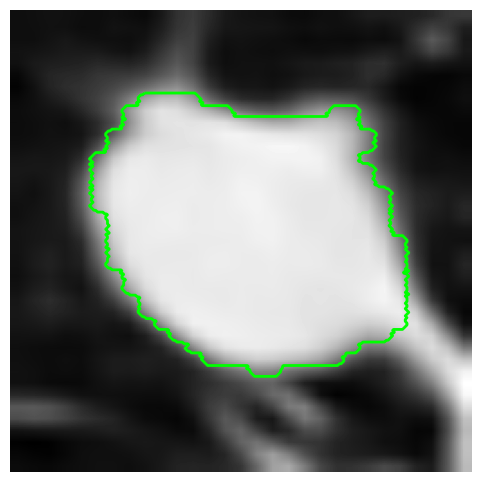

In [24]:
import cv2
fig, ax = plt.subplots(1,1, figsize=(6,6), frameon=False)
sample = dataset.get_sample(0)
img = sample.image[:,:,0]
mask = sample.gt_mask
print(np.max(img), np.min(img))
cropped_image= img[step_info['global_roi'][0]:step_info['global_roi'][1], step_info['global_roi'][2]:step_info['global_roi'][3]]
cropped_mask = mask[step_info['global_roi'][0]:step_info['global_roi'][1], step_info['global_roi'][2]:step_info['global_roi'][3]]
print(cropped_image.shape, cropped_mask.shape)
cropped_image = cv2.resize(cropped_image, (256, 256))
cropped_mask = cv2.resize(cropped_mask.astype(np.uint8), (256, 256))
ax.imshow(cropped_image, cmap='gray')
# ax.set_xlim(220,249)
# ax.set_ylim(174,135)
ax.contour(cropped_mask, levels=[0.5], colors='lime', linewidths=2)
ax.axis('off')

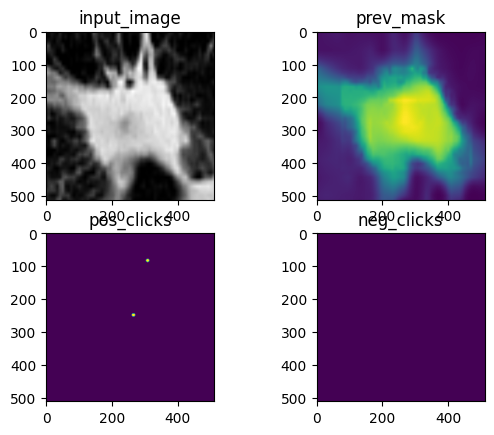

In [23]:
def show_coarse_input(info):
    
    info = info['coarse_seg']
    
    fig, ax = plt.subplots(2, 2)
    plt.close()
    
    ax[0, 0].set_title('input_image')
    ax[0, 0].imshow(info['prepared_input']['image'].cpu()[0, 0], cmap='gray')
    
    ax[0, 1].set_title('prev_mask')
    ax[0, 1].imshow(info['prepared_input']['prev_mask'].cpu()[0, 0])
    
    ax[1, 0].set_title('pos_clicks')
    ax[1, 0].imshow(info['click_map'].cpu()[0, 0])
    
    ax[1, 1].set_title('neg_clicks')
    ax[1, 1].imshow(info['click_map'].cpu()[0, 1])
    
    return fig

show_coarse_input(step_info)

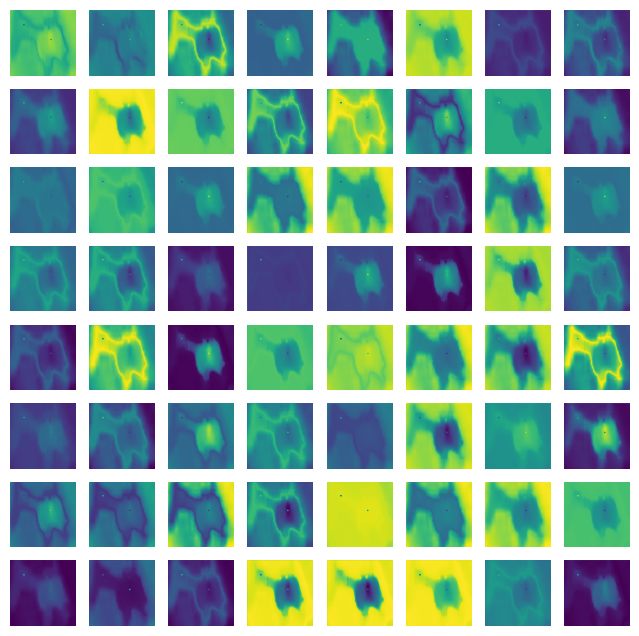

In [56]:
def show_coarse_click_features(info):
    
    features = info['coarse_seg']['small_coord_features'].cpu()[0]
    
    fig, ax = plt.subplots(8, 8, figsize=(8, 8))
    plt.close()
    
    for i in range(features.shape[0]):
        ax[i//8, i%8].imshow(features[i])
        ax[i//8, i%8].axis('off')
    
    return fig

show_coarse_click_features(step_info)

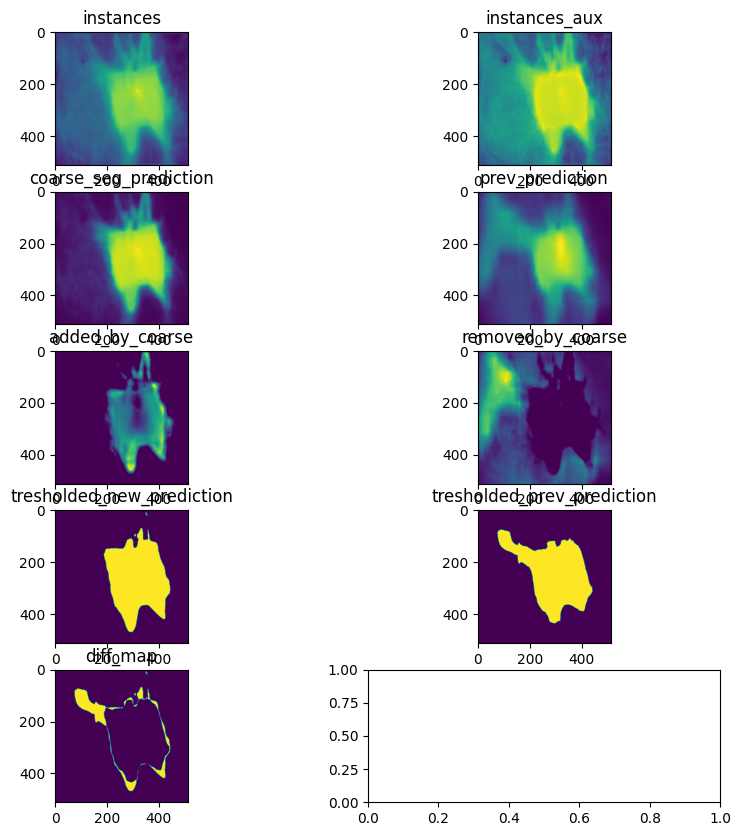

In [57]:
def show_coarse_predictions(info):

    fig, ax = plt.subplots(5, 2, figsize=(10, 10))
    plt.close()
    
    ax[0, 0].set_title('instances')
    ax[0, 0].imshow(info['coarse_seg']['outputs']['instances'].cpu()[0, 0])
    
    ax[0, 1].set_title('instances_aux')
    ax[0, 1].imshow(info['coarse_seg']['outputs']['instances_aux'].cpu()[0, 0])
    
    ax[1, 0].set_title('coarse_seg_prediction')
    new_mask = torch.sigmoid(info['coarse_seg']['outputs']['instances'].cpu()[0, 0]).numpy()
    ax[1, 0].imshow(new_mask)
    
    # ax[1, 1].set_title('coarse_seg_mask')
    # ax[1, 1].imshow(info['coarse_seg_mask'])
    ax[1,1].set_title('prev_prediction')
    ax[1,1].imshow(info['coarse_seg']['prepared_input']['prev_mask'].cpu()[0, 0])
    
    prev_mask = info['coarse_seg']['prepared_input']['prev_mask'].cpu()[0, 0].numpy()
    mask_diff = np.abs(new_mask - prev_mask)
    
    added_by_coarse_mask = new_mask > prev_mask
    removed_by_coarse_mask = new_mask < prev_mask
    added_by_coarse_map = mask_diff.copy()
    added_by_coarse_map[removed_by_coarse_mask] = 0
    removed_by_coarse_map = mask_diff.copy()
    removed_by_coarse_map[added_by_coarse_mask] = 0
    
    ax[2, 0].set_title('added_by_coarse')
    ax[2, 0].imshow(added_by_coarse_map)
    ax[2, 1].set_title('removed_by_coarse')
    ax[2, 1].imshow(removed_by_coarse_map)
    
    
    ax[3, 0].set_title('tresholded_new_prediction')
    ax[3, 0].imshow(new_mask > 0.5)
    ax[3, 1].set_title('tresholded_prev_prediction')
    ax[3, 1].imshow(prev_mask > 0.5)
    ax[4, 0].set_title('diff_map')
    ax[4, 0].imshow(np.logical_xor(new_mask > 0.5, prev_mask > 0.5))
    
    return fig

show_coarse_predictions(step_info)

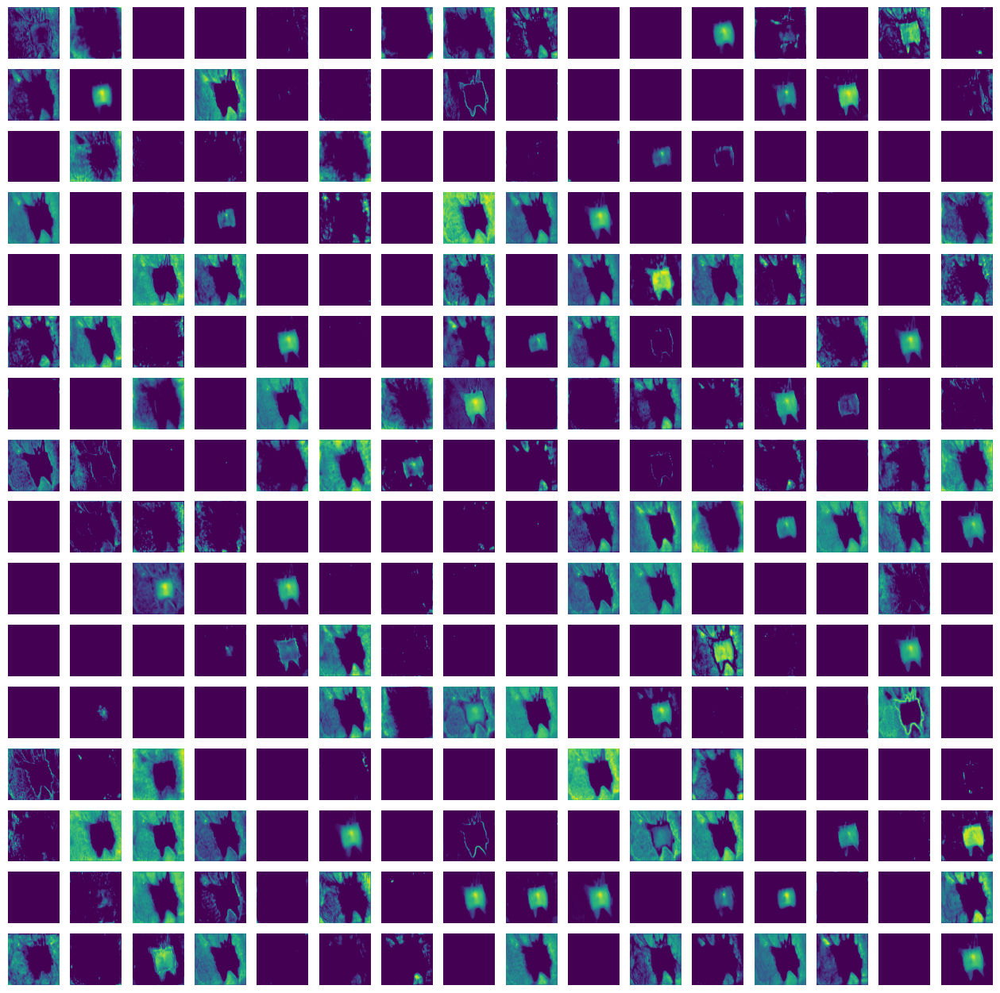

In [58]:
def show_coarse_pass_features(info):
    
    features = info['coarse_seg']['outputs']['feature'].cpu()[0]
    
    fig, ax = plt.subplots(16, 16, figsize=(16, 16))
    plt.close()
    
    for i in range(features.shape[0]):
        ax[i//16, i%16].imshow(features[i])
        ax[i//16, i%16].axis('off')
    
    return fig

show_coarse_pass_features(step_info)

points_nd: tensor([[[416.0000, 733.8667,   0.0000, 122.6667],
         [160.0000, 170.6667,   0.0000, 122.6667]]], device='cuda:0',
       dtype=torch.float64)
roi: tensor([[  0.0000,  43.7073,  41.5135, 231.0244, 262.9189]], device='cuda:0')


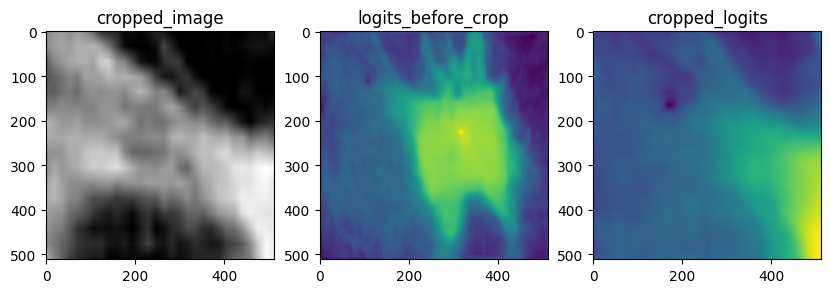

In [59]:
def show_refine_crop(info):
    info = info['refine_info']

    print(f'points_nd: {info["points_nd"]}')
    print(f'roi: {info["roi"]}')
    
    fig, ax = plt.subplots(1, 3, figsize=(10, 10))
    
    ax[0].set_title('cropped_image')
    ax[0].imshow(info['refine_pass']['cropped_image'].cpu()[0, 0], cmap='gray')
    ax[1].set_title('logits_before_crop')
    ax[1].imshow(info['refine_pass']['logits_before_crop'].cpu()[0, 0])
    
    ax[2].set_title('cropped_logits')
    ax[2].imshow(info['refine_pass']['cropped_logits'].cpu()[0, 0])
    
show_refine_crop(step_info)

points_nd: tensor([[[416.0000, 733.8667,   0.0000, 122.6667],
         [160.0000, 170.6667,   0.0000, 122.6667]]], device='cuda:0',
       dtype=torch.float64)
roi: tensor([[  0.0000,  43.7073,  41.5135, 231.0244, 262.9189]], device='cuda:0')


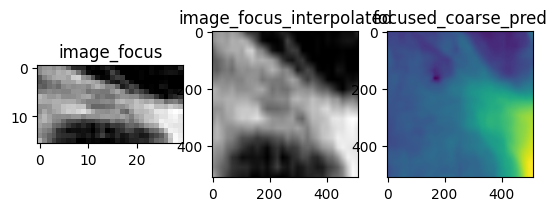

In [60]:
def show_refine_inputs(info):
    info = info['refine_info']

    print(f'points_nd: {info["points_nd"]}')
    print(f'roi: {info["roi"]}')
    
    fig, ax = plt.subplots(1, 3)
    
    ax[0].set_title('image_focus')
    ax[0].imshow(info['image_focus'].cpu()[0, 0], cmap='gray')
    ax[1].set_title('image_focus_interpolated')
    ax[1].imshow(info['image_focus_interpolated'].cpu()[0, 0], cmap='gray')
    
    ax[2].set_title('focused_coarse_pred')
    ax[2].imshow(info['refine_pass']['cropped_logits'].cpu()[0, 0])
    
show_refine_inputs(step_info)

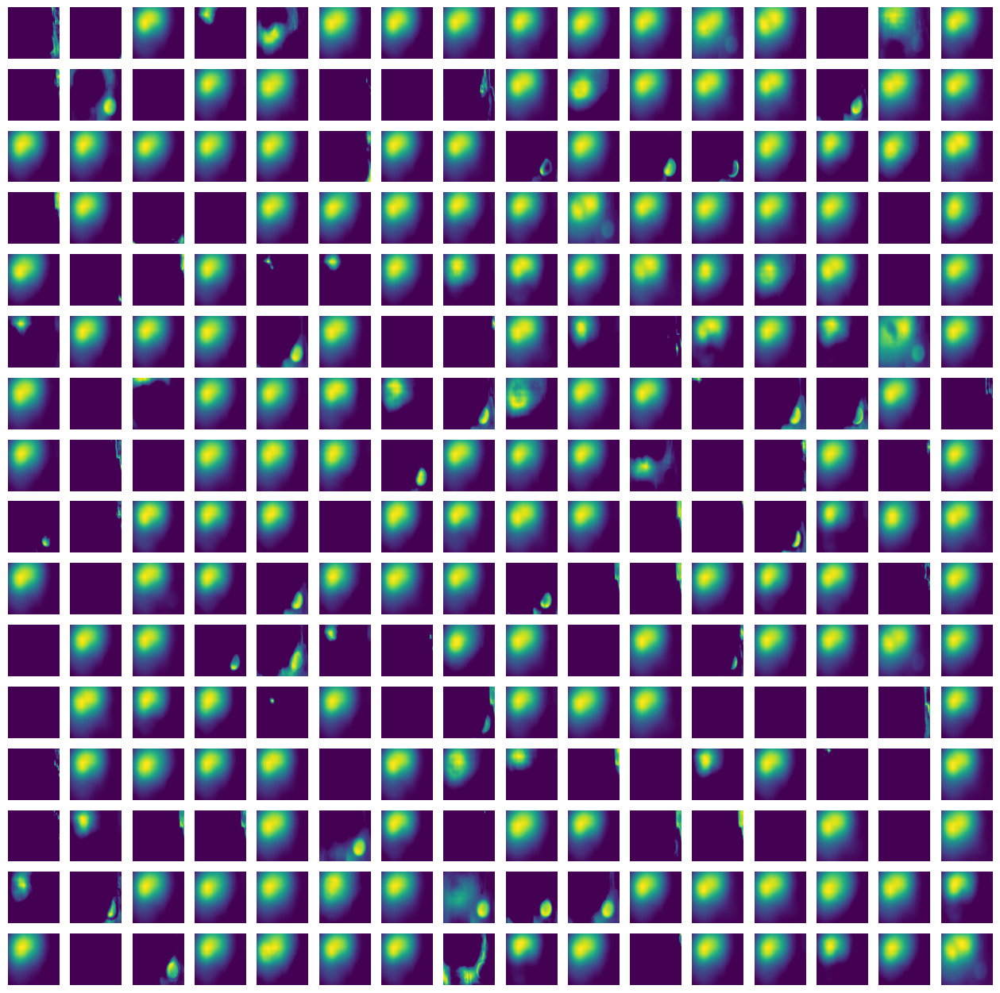

In [38]:
def show_cropped_refine_features(info):
    
    features = info['refine_info']['refine_pass']['cropped_feature'].cpu()[0]
    
    fig, ax = plt.subplots(16, 16, figsize=(16, 16))
    plt.close()
    
    for i in range(features.shape[0]):
        ax[i//16, i%16].imshow(features[i])
        ax[i//16, i%16].axis('off')
    
    return fig

show_cropped_refine_features(step_info)

torch.Size([1, 32, 256, 256]) torch.Size([1, 32, 256, 256]) torch.Size([1, 32, 256, 256])


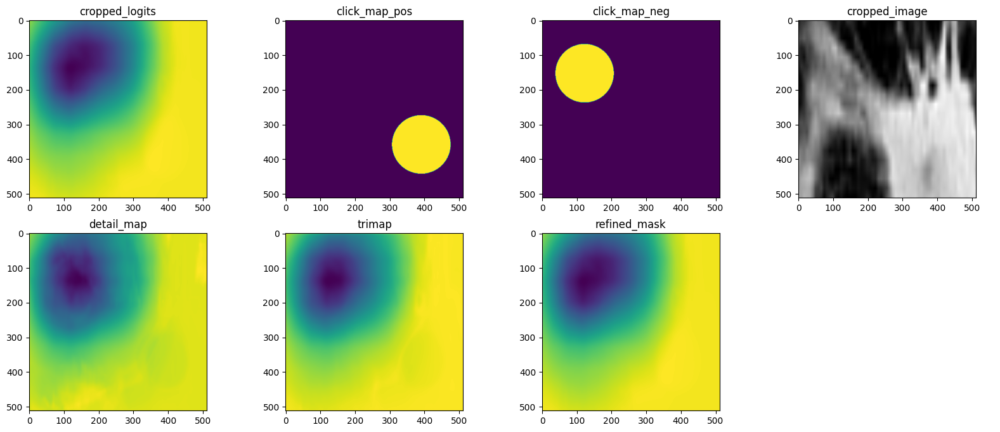

In [39]:
def show_refine_pass(info):
    info = info['refine_info']['refine_pass']
    
    fig, ax = plt.subplots(2, 4, figsize=(20, 8))
    
    ax[0,0].set_title('cropped_logits')
    ax[0,0].imshow(info['cropped_logits'].cpu()[0, 0])
    ax[0,1].set_title('click_map_pos')
    ax[0,1].imshow(info['click_map'].cpu()[0, 0])
    ax[0,2].set_title('click_map_neg')
    ax[0,2].imshow(info['click_map'].cpu()[0, 1])
    
    ax[0,3].set_title('cropped_image')
    ax[0,3].imshow(info['cropped_image'].cpu()[0, 0], cmap='gray')
    
    refiner_info = info['refiner_info']
    # ax[0,3].set_title('squeezed_features')
    print(refiner_info['squeezed_features'].cpu().shape, refiner_info['predicted_features_1'].cpu().shape, refiner_info['predicted_features_2'].cpu().shape)
    # ax[0,3].imshow(refiner_info['squeezed_features'].cpu()[0])
    
    # ax[0,4].set_title('predicted_features_1')
    # ax[0,4].imshow(refiner_info['predicted_features_1'].cpu()[0, 0])
    
    # ax[1,0].set_title('predicted_features_2')
    # ax[1,0].imshow(refiner_info['predicted_features_2'].cpu()[0, 0])
    
    ax[1,0].set_title('detail_map')
    ax[1,0].imshow(refiner_info['detail_map'].cpu()[0, 0])
    
    ax[1,1].set_title('trimap')
    ax[1,1].imshow(refiner_info['trimap'].cpu()[0, 0])
    ax[1,2].set_title('refined_mask')
    ax[1,2].imshow(info['refined_mask'].cpu()[0, 0])
    
    ax[1,3].axis('off')
    
show_refine_pass(step_info)

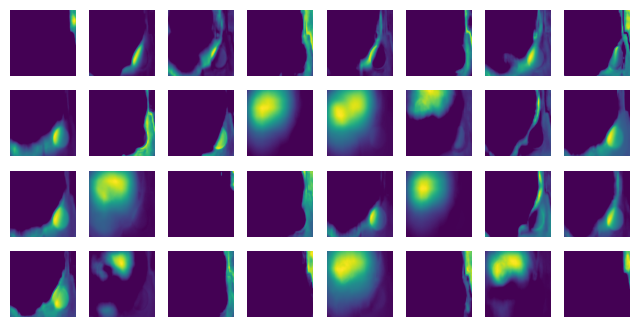

In [40]:
def show_squeezed_coarse_features(info):
    
    features = info['refine_info']['refine_pass']['refiner_info']['squeezed_features'].cpu()[0]
    
    fig, ax = plt.subplots(4, 8, figsize=(8,4))
    plt.close()
    
    for i in range(features.shape[0]):
        ax[i//8, i%8].imshow(features[i])
        ax[i//8, i%8].axis('off')
    
    return fig

show_squeezed_coarse_features(step_info)

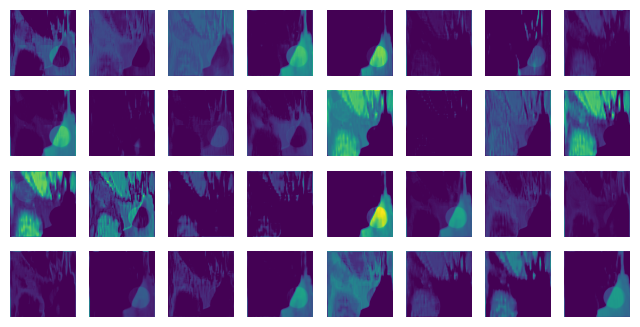

In [41]:
def show_refiner_first_pass_features(info):
    
    features = info['refine_info']['refine_pass']['refiner_info']['predicted_features_1'].cpu()[0]
    
    fig, ax = plt.subplots(4, 8, figsize=(8,4))
    plt.close()
    
    for i in range(features.shape[0]):
        ax[i//8, i%8].imshow(features[i])
        ax[i//8, i%8].axis('off')
    
    return fig

show_refiner_first_pass_features(step_info)

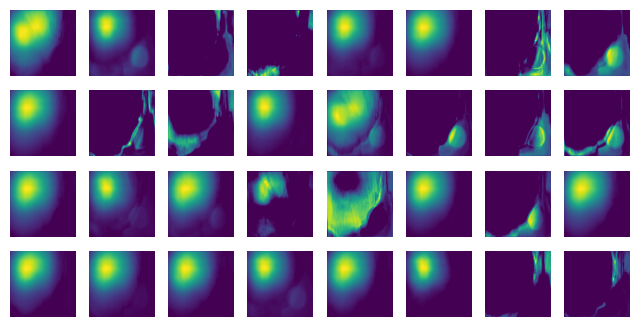

In [42]:
def show_refiner_second_pass_features(info):
    
    features = info['refine_info']['refine_pass']['refiner_info']['predicted_features_2'].cpu()[0]
    
    fig, ax = plt.subplots(4, 8, figsize=(8,4))
    plt.close()
    
    for i in range(features.shape[0]):
        ax[i//8, i%8].imshow(features[i])
        ax[i//8, i%8].axis('off')
    
    return fig

show_refiner_second_pass_features(step_info)

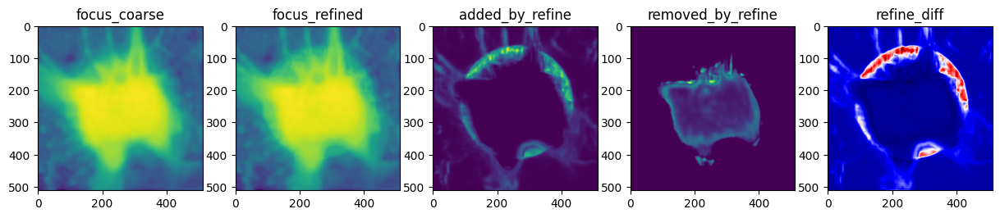

In [19]:
def show_refine_outputs(info):
    info = info['refine_info']
    
    fig, ax = plt.subplots(1,5, figsize=(15, 3))
    
    ax[0].set_title('focus_coarse')
    ax[0].imshow(info['focus_coarse'])
    ax[1].set_title('focus_refined')
    ax[1].imshow(info['focus_refined'])
    
    refine_diff = np.abs(info['focus_refined'] - info['focus_coarse'])
    added_by_refine_mask = info['focus_refined'] > info['focus_coarse']
    removed_by_refine_mask = info['focus_refined'] < info['focus_coarse']
    added_by_refine_map = refine_diff.copy()
    added_by_refine_map[removed_by_refine_mask] = 0
    removed_by_refine_map = refine_diff.copy()
    removed_by_refine_map[added_by_refine_mask] = 0
    
    ax[2].set_title('added_by_refine')
    ax[2].imshow(added_by_refine_map)
    ax[3].set_title('removed_by_refine')
    ax[3].imshow(removed_by_refine_map)
    
    ax[4].set_title('refine_diff')
    ax[4].imshow(info['focus_refined'] - info['focus_coarse'], cmap='seismic')
show_refine_outputs(step_info)

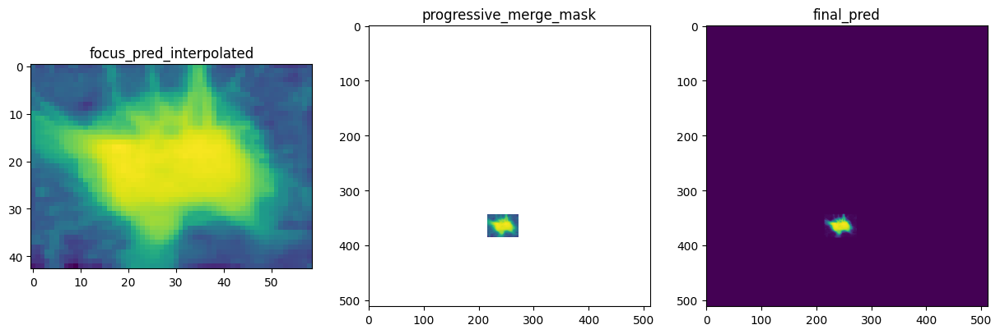

In [20]:
def show_final_output(info):
    fig, ax = plt.subplots(1, 3, figsize=(15, 5))
    
    ax[0].set_title('focus_pred_interpolated')
    ax[0].imshow(info['focus_pred_interpolated'])
    if info['progressive_merge_mask'] is not None:
        ax[1].set_title('progressive_merge_mask')
        ax[1].imshow(info['progressive_merge_mask'])
    else:
        ax[1].set_title('progressive_merge_mask (NONE)')
        ax[1].imshow(np.zeros_like(info['focus_pred_interpolated']))
    ax[2].set_title('final_pred')
    ax[2].imshow(info['final_pred'])
    
# show_final_output(info_list[1])
show_final_output(step_info)

In [21]:
def show_progressive_merge(info, coords = None):
    if not info['progressive_merge_activated']:
        return
    
    info = info['progressive_info']
    
    
    if coords is None:
        y_start, y_end, x_start, x_end = 0, info['previous_mask'].shape[0], 0, info['previous_mask'].shape[1]
    else:
        y_start, y_end, x_start, x_end = coords
        
    
    fig, ax = plt.subplots(2,3, figsize=(15, 10))
    ax[0, 0].set_title('previous_mask')
    ax[0, 0].imshow(info['previous_mask'][y_start:y_end, x_start:x_end])
    # ax[0, 0].scatter(info['click_coords'][1], info['click_coords'][0], c= 'lime' if info['click_is_positive'] else 'red', s=1)
    ax[0, 1].set_title('predicted_mask')
    ax[0, 1].imshow(info['predicted_mask'][y_start:y_end, x_start:x_end])
    ax[0, 2].set_title('difference_regions')
    ax[0, 2].imshow(info['diff_regions'][y_start:y_end, x_start:x_end])
    ax[1, 0].set_title(f'{len(np.unique(info["connected_labels"]))} connected_components')
    ax[1, 0].imshow(info['connected_labels'][y_start:y_end, x_start:x_end], cmap='tab20')
    ax[1, 1].set_title('correction_mask')
    ax[1, 1].imshow(info['corr_mask'][y_start:y_end, x_start:x_end])
    # ax[1, 1].scatter(info['click_coords'][1], info['click_coords'][0], c= 'lime' if info['click_is_positive'] else 'red', s=1)
    ax[1, 2].set_title(f'mask after {"subtracting" if info["prev_mask_positive"] else "adding"} correction')
    ax[1, 2].imshow(info['progressive_mask_construction']['progressive_mask'][y_start:y_end, x_start:x_end])
    
show_progressive_merge(step_info)

# Animation code

In [198]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import base64

def show_animation(animation):
    html = animation.to_jshtml()
    
    return HTML(html)

def show_animation_from_file(filename):
    
    with open(filename, 'rb') as f:
        gif_data = f.read()

    gif_base64 = base64.b64encode(gif_data).decode('utf-8')

    html_code = f'<img src="data:image/gif;base64,{gif_base64}">'
    return HTML(html_code)

def save_animation(animation, filename):
    animation.save(f'{filename}.gif', writer='pillow')
    
def generate_click_animation(image, gt_mask, iou_values, clicks, predictions, info_list):
    fig, ax = plt.subplots(3, 3, figsize=(24, 14))
    if len(image.shape) == 3:
        image = image[:, :, 0]
        
    num_frames = len(clicks)
        
    ax[0,0].imshow(image, cmap='gray')
    ax[0,0].axis('off')
    ax[0,0].set_title('Image, gt mask,\nClicks', fontsize=20)
    ax[0,0].contour(gt_mask, colors='b', alpha=0.5, linewidths=0.1)

    ax[1, 1].set_title('Coarse logits')
    
    plt.close()
    
    def update(frame_index):
        
        fig.suptitle(f'Click {frame_index + 1}', fontsize=20)
        
        ax[0,0].imshow(image, cmap='gray')
        ax[0,0].set_title(f'Clicks: {frame_index + 1}', fontsize=20)
        ax[0,0].contour(gt_mask, colors='b', alpha=0.5, linewidths=0.1)
        for click in clicks[:frame_index + 1]:
            color = 'lime' if click.is_positive else 'r'
            y, x = click.coords
            ax[0,0].scatter(x, y, s=20, c=color)
            
        ax[0,1].clear()
        ax[0,1].set_title('Previous predicition', fontsize=20)
        ax[0,1].axis('off')
        ax[0,1].imshow(info_list[frame_index]['prev_mask'])
        
        ax[0,2].clear()
        ax[0,2].axis('off')
        ax[0,2].set_title(f'Input image', fontsize=20)
        ax[0,2].imshow(info_list[frame_index]['image_transforms']['image_nd'].cpu()[0, 0], cmap='gray')
        
        image_transforms = info_list[frame_index]['image_transforms']
        ax[1,0].clear()
        ax[1,0].set_title('Click map', fontsize=20)
        ax[1,0].axis('off')
        ax[1,0].imshow(image_transforms['image_nd'].cpu()[0, 3], cmap='gray')
        
        # start_y, end_y, start_x, end_x = info_list[frame_index]['global_roi']
        # cur_clicks = image_transforms['clicks_lists'][0]
        # y = [click.coords[0] for click in image_transforms['clicks_lists'][0]]
        # x = [click.coords[1] for click in image_transforms['clicks_lists'][0]]
        # c = [click.is_positive for click in image_transforms['clicks_lists'][0]]
        # c = ['lime' if i else 'red' for i in c]
        # ax[1,0].scatter(x, y, c=c, s=20)
        
        
        pos_click_map = info_list[frame_index]['coarse_seg']['click_map'].cpu()[0, 0]
        neg_click_map = info_list[frame_index]['coarse_seg']['click_map'].cpu()[0, 1]
        pos_overlay = np.ma.masked_where(pos_click_map == 0, pos_click_map)
        neg_overlay = np.ma.masked_where(neg_click_map == 0, neg_click_map)
        ax[1,0].imshow(np.dstack((np.zeros_like(pos_overlay), pos_overlay, np.zeros_like(pos_overlay), pos_overlay*0.5)), interpolation='nearest')
        ax[1,0].imshow(np.dstack((neg_overlay, np.zeros_like(neg_overlay), np.zeros_like(neg_overlay), neg_overlay*0.5)), interpolation='nearest')

        
        ax[1,1].clear()
        ax[1,1].set_title('Coarse prediction', fontsize=20)
        ax[1,1].axis('off')
        ax[1,1].imshow(info_list[frame_index]['coarse_seg_prediction'])
        
        ax[1,2].clear()
        ax[1,2].axis('off')
        ax[1,2].set_title('Interpolated focus crop', fontsize=20)
        ax[1,2].imshow(info_list[frame_index]['refine_info']['image_focus_interpolated'].cpu()[0, 0], cmap='gray')
        
        ax[2,0].clear()
        ax[2,0].axis('off')
        ax[2,0].set_title('Focus coarse segmentation', fontsize=20)
        ax[2,0].imshow(info_list[frame_index]['refine_info']['focus_coarse'])
        
        ax[2,1].clear()
        ax[2,1].axis('off')
        ax[2,1].set_title('Focus refined segmentation', fontsize=20)
        ax[2,1].imshow(info_list[frame_index]['refine_info']['focus_refined'])
        
        # ax[2,2].clear()
        # ax[2,2].axis('off')
        # ax[2,2].set_title(f'Final segmentation, IOU:{iou_values[frame_index]:.3f}', fontsize=20)
        # ax[2,2].imshow(pred_list[frame_index])
        
        ax[2,2].clear()
        ax[2,2].axis('off')
        ax[2,2].set_title(f'Final prediction', fontsize=20)
        ax[2,2].imshow(info_list[frame_index]['final_pred'])
        
        return
    
    animation = FuncAnimation(fig, update, frames=num_frames, interval=1000, blit=False)
    return animation

anim = generate_click_animation(image, gt_mask, ious_arr, clicks_list, pred_list, info_list)
show_animation(anim)

2024-05-03 19:44:52,420 [MainThread  ] [INFO ]  Animation.save using <class 'matplotlib.animation.HTMLWriter'>
2024-05-03 19:44:52,420 [MainThread  ] [INFO ]  Animation.save using <class 'matplotlib.animation.HTMLWriter'>
2024-05-03 19:44:52,420 [MainThread  ] [INFO ]  Animation.save using <class 'matplotlib.animation.HTMLWriter'>
2024-05-03 19:44:52,420 [MainThread  ] [INFO ]  Animation.save using <class 'matplotlib.animation.HTMLWriter'>
